# echarts4r
## R交互式可视化

In [1]:
library(tidyverse)
library(echarts4r)

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.3.5     ✔ purrr   0.3.4
✔ tibble  3.1.6     ✔ dplyr   1.0.9
✔ tidyr   1.2.0     ✔ stringr 1.4.0
✔ readr   2.1.2     ✔ forcats 0.5.1
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()


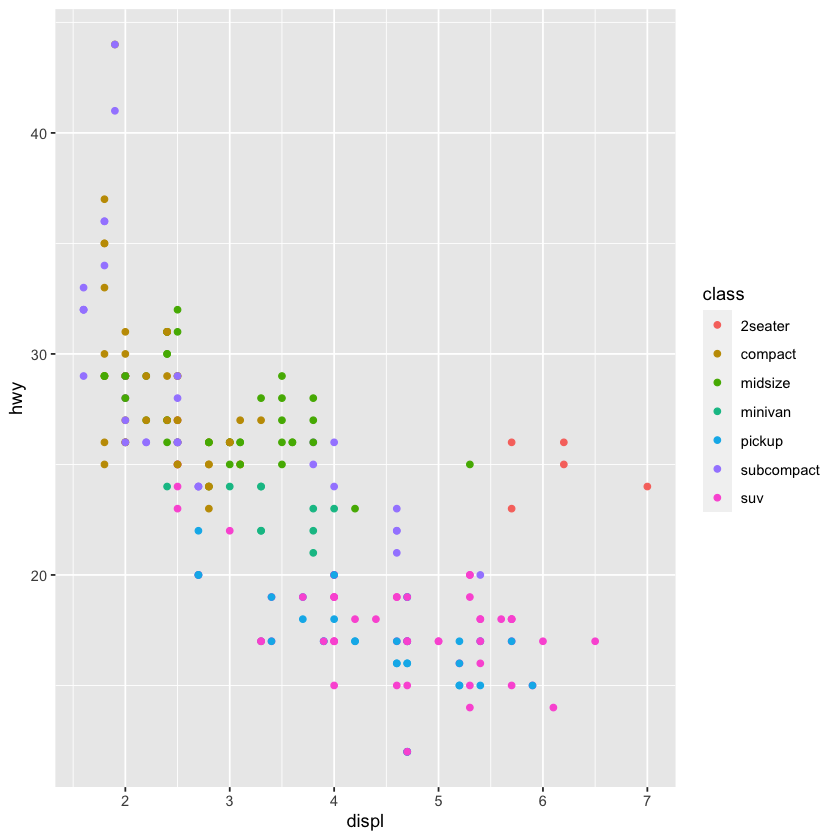

In [2]:
ggplot(mpg, aes(displ, hwy, colour = class)) + geom_point() # ggplot图可以显示，echarts图不显示。。。

In [3]:
df <- state.x77  %>% 
  as.data.frame() %>% 
  tibble::rownames_to_column("State")

head(df)

,State,Population,Income,Illiteracy,Life Exp,Murder,HS Grad,Frost,Area
,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,Alabama,3615,3624,2.1,69.05,15.1,41.3,20,50708
2,Alaska,365,6315,1.5,69.31,11.3,66.7,152,566432
3,Arizona,2212,4530,1.8,70.55,7.8,58.1,15,113417
4,Arkansas,2110,3378,1.9,70.66,10.1,39.9,65,51945
5,California,21198,5114,1.1,71.71,10.3,62.6,20,156361
6,Colorado,2541,4884,0.7,72.06,6.8,63.9,166,103766


In [4]:
df %>% 
    e_charts(x = State) %>%         # 州为横轴
    e_line(serie = Population, smooth = TRUE) %>% 
    e_area(Income, smooth = TRUE) %>% 
    e_axis_labels(x = "State") %>%  # x轴标题
    e_title("US State", "Population & Income") %>%  # 图表主标题和子标题
    e_theme("infographic") %>%      # 换主题
    e_legend(right = 0) %>%         # 图例显示到右侧
    e_tooltip(trigger = "axis")     # 鼠标位置显示动态提示 

HTML widgets cannot be represented in plain text (need html)

## Advanced

In [5]:
e_common(
    font_family = "Raleway",
    theme = NULL
)

In [6]:
head(iris)

,Sepal.Length,Sepal.Width,Petal.Length,Petal.Width,Species
,<dbl>,<dbl>,<dbl>,<dbl>,<fct>
1,5.1,3.5,1.4,0.2,setosa
2,4.9,3.0,1.4,0.2,setosa
3,4.7,3.2,1.3,0.2,setosa
4,4.6,3.1,1.5,0.2,setosa
5,5.0,3.6,1.4,0.2,setosa
6,5.4,3.9,1.7,0.4,setosa


In [7]:
iris %>% 
    group_by(Species) %>% 
    e_charts(Sepal.Length) %>% 
    e_line(Sepal.Width) %>% 
    e_title("Group data")

HTML widgets cannot be represented in plain text (need html)

In [8]:
iris %>% 
    group_by(Species) %>% 
    e_charts(Sepal.Length, timeline = TRUE) %>% # 添加时间轴，按时间顺序展示
    e_line(Sepal.Width) %>% 
    e_title("Group data")

HTML widgets cannot be represented in plain text (need html)

In [10]:
df <- data.frame(
    x = LETTERS[1:10], # 前十个大写字母A、B。。。
    a = runif(10),
    b = runif(10),
    c = runif(10),
    d = runif(10)
)

df
df %>% 
    e_charts(x) %>% 
    e_bar(a, stack = "grp") %>% 
    e_bar(b, stack = "grp") %>% 
    e_bar(c, stack = "grp") %>% 
    e_bar(d, stack = "grp")

x,a,b,c,d
<chr>,<dbl>,<dbl>,<dbl>,<dbl>
A,0.3413496,0.74359683,0.72973031,0.5682732
B,0.9145831,0.65614069,0.36817079,0.7615267
C,0.1166094,0.26348273,0.06874994,0.8081900
D,0.1072310,0.48747822,0.28932222,0.9458068
E,0.5509470,0.41301813,0.48192493,0.7676848
F,0.1760468,0.49726654,0.58498646,0.2480790
G,0.2144225,0.04771303,0.66466704,0.9179153
H,0.9599500,0.72258539,0.24742426,0.8131835
I,0.1766744,0.58035499,0.79987085,0.9321598


HTML widgets cannot be represented in plain text (need html)

In [11]:
iris %>% 
    group_by(Species) %>% 
    e_charts(Sepal.Length) %>% 
    e_scatter(Petal.Length, Sepal.Width) # 散点图

HTML widgets cannot be represented in plain text (need html)

## 缩放

In [13]:
my_scale <- function(x){
    scales::rescale(x, to = c(5, 30))
}

iris  %>% 
    group_by(Species) %>% 
    e_charts(Sepal.Length) %>% 
    e_scatter(Petal.Length, Sepal.Width, scale = my_scale)

HTML widgets cannot be represented in plain text (need html)

In [14]:
# R 4.1.0可以这样用
iris %>% 
    group_by(Species) %>% 
    e_charts(Sepal.Length) %>% 
    e_scatter(
        Petal.Length,
        Sepal.Width,
        scale = \(x) scales::rescale(x, to = c(5, 30))
    )

HTML widgets cannot be represented in plain text (need html)

In [17]:
iris |> 
    group_by(Species) |> 
    e_charts(Sepal.Length) |> 
    e_scatter(Petal.Length, symbol_size = 15)

HTML widgets cannot be represented in plain text (need html)

In [20]:
iris |> 
    group_by(Species) |> 
    e_charts(Sepal.Length) |> 
    e_scatter(Petal.Length, Sepal.Width, scale = log1p, symbol_size = 5)

HTML widgets cannot be represented in plain text (need html)

In [21]:
echart <- mtcars |> 
  e_charts(mpg) |> 
  e_scatter(qsec, wt, scale = e_scale) |> 
  e_legend(show = FALSE)

echart |> 
  e_visual_map(wt, scale = e_scale)

HTML widgets cannot be represented in plain text (need html)

In [23]:
mtcars |> 
  e_charts(mpg) |> 
  e_scatter(qsec, wt, scale = NULL, scale_js = "function(data){ return data[3] * 3;}") |> 
  e_legend(show = FALSE) |> 
  e_visual_map(wt, scale = NULL)

HTML widgets cannot be represented in plain text (need html)

In [24]:
mtcars |> 
  e_charts(cyl) |> 
  e_scatter(drat, symbol_size = 4) |> 
  e_scatter(
    drat, jitter_factor = 2, symbol_size = 6,
    name = "noisy"
  )

HTML widgets cannot be represented in plain text (need html)

In [25]:
v <- LETTERS[1:10]
matrix <- data.frame(
  x = sample(v, 300, replace = TRUE), 
  y = sample(v, 300, replace = TRUE), 
  z = rnorm(300, 10, 1),
  stringsAsFactors = FALSE
) |> 
  dplyr::group_by(x, y) |> 
  dplyr::summarise(z = sum(z)) |> 
  dplyr::ungroup()

matrix |> 
  e_charts(x) |> 
  e_heatmap(y, z) |> 
  e_visual_map(z)

`summarise()` has grouped output by 'x'. You can override using the `.groups`
argument.


HTML widgets cannot be represented in plain text (need html)

In [26]:
dates <- seq.Date(as.Date("2018-01-01"), as.Date("2018-12-31"), by = "day")
values <- rnorm(length(dates), 20, 6)

year <- data.frame(date = dates, values = values)

year |> 
  e_charts(date) |> 
  e_calendar(range = "2018") |> 
  e_heatmap(values, coord_system = "calendar") |> 
  e_visual_map(max = 30)

HTML widgets cannot be represented in plain text (need html)

In [27]:
df <- data.frame(x = 1:10, y = seq(1, 20, by = 2))

df |> 
  e_charts(x) |> 
  e_line(y) 

HTML widgets cannot be represented in plain text (need html)

In [28]:
df |> 
  e_charts(x) |> 
  e_polar() |> 
  e_angle_axis() |> 
  e_radius_axis() |> 
  e_line(y, coord_system = "polar", smooth = TRUE) 

HTML widgets cannot be represented in plain text (need html)

In [29]:
USArrests |> 
  e_charts(Assault) |> 
  e_line(Murder, smooth = TRUE) |> 
  e_line(Rape, y_index = 1) |>  # add secondary axis
  e_y_axis(splitLine = list(show = FALSE)) # hide split lines on first Y axis

HTML widgets cannot be represented in plain text (need html)

In [30]:
data.frame(
  x = LETTERS[1:5],
  y = runif(5, 1, 15)
) |> 
  e_charts(x) |> 
  e_bar(y, name = "flipped") |> 
  e_flip_coords() # flip axis

HTML widgets cannot be represented in plain text (need html)

In [31]:
USArrests |> 
  tibble::rownames_to_column("State") |> 
  dplyr::mutate(
    Rape = -Rape
  ) |> 
  e_charts(State) |> 
  e_area(Murder) |>
  e_bar(Rape, name = "Sick basterd", x_index = 1) |> # second y axis 
  e_mark_line("Sick basterd", data = list(type = "average")) |> 
  e_mark_point("Murder", data = list(type = "min"))

HTML widgets cannot be represented in plain text (need html)

In [22]:
library(dplyr)
df <- tibble(
  name = "earth",        # 1st level
  children = list(
    tibble(name = c("land", "ocean"),             # 2nd level
       children = list(
         tibble(name = c("forest", "river")),   # 3rd level 
         tibble(name = c("fish", "kelp"),
            children = list(
               tibble(name = c("shark", "tuna"),  # 4th level 
               NULL  # kelp
            ))
         )
       ))
  )
)

df |> 
  e_charts() |> 
  e_tree()

HTML widgets cannot be represented in plain text (need html)

In [32]:
df |> 
  e_charts() |> 
  e_tree(layout = "radial")

HTML widgets cannot be represented in plain text (need html)

In [33]:
USArrests |> 
  tibble::rownames_to_column("State") |> 
  dplyr::slice(1:10) |> 
  e_charts(State) |> 
  e_area(Murder, label = list(normal = list(show = TRUE))) 

HTML widgets cannot be represented in plain text (need html)

In [34]:
USArrests |> 
  tibble::rownames_to_column("State") |> 
  dplyr::slice(1:10) |> 
  e_charts(State) |> 
  e_area(Murder) |> 
  e_labels()

HTML widgets cannot be represented in plain text (need html)

In [35]:
# add columns to iris
iris_dat <- iris |> 
  dplyr::mutate(
    show = TRUE, # to show the labels
    fontSize = exp(Sepal.Length) / 10, # font size will correspond to Sepal.Length
    color = sample(c("red", "black", "blue"), dplyr::n(), replace = TRUE) # assign a random color to the label
  )

iris_dat |> 
  dplyr::slice(1:10) |> # simplify the graph. 
  e_charts(Sepal.Width) |> 
  e_line(Sepal.Length) |> 
  e_add_nested("label", show, fontSize, color) |> # add our columns to "label"
  e_x_axis(min = 2.5)

HTML widgets cannot be represented in plain text (need html)

In [36]:
funnel <- data.frame(
  stage = c("View", "Click", "Purchase"), 
  value = c(80, 30, 20),
  color = c("blue", "red", "green")
)

funnel |> 
  e_charts() |> 
  e_funnel(value, stage) |> 
  e_add_nested("itemStyle", color)

HTML widgets cannot be represented in plain text (need html)

In [37]:
N <- 20 # data points

opts <- list(
  xAxis = list(
    type = "category",
    data = LETTERS[1:N]
  ),
  yAxis = list(
    type = "value"
  ),
  series = list(
    list(
      type = "line",
      data = round(runif(N, 5, 20))
    )
  )
)

e_charts() |> 
  e_list(opts)

HTML widgets cannot be represented in plain text (need html)